<a href="https://colab.research.google.com/github/ruilong96/Airbnb-baseline-visualization/blob/master/Airbnb_Exploration_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Airbnb Data Part 2
By Ruilong Zhuang, Tina Tao, Tracy Cui

In [ ]:
!pip install geojson-utils
!pip install geopandas
!pip install folium==0.5.0

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
import sys
from pathlib import Path
sys.path.append(str(Path('/content/drive/My Drive/Data_Analysis')))
# Load libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pytz import timezone
import datetime

import altair as alt
import folium, json

import geopandas as gpd
import pandas as pd
import numpy as np


In [9]:
data_path_str = "/content/drive/MyDrive/Data_Analysis/airbnb/A Dataset of Your Own 06"

In [10]:
listing_df = pd.read_csv(Path(data_path_str+'/listings.csv'))
listing_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,109,Amazing bright elegant condo park front *UPGRA...,521,Paolo,Other Cities,Culver City,33.98209,-118.38494,Entire home/apt,122,30,2,2016-05-15,0.02,1,0
1,344,Family perfect;Pool;Near Studios!,767,Melissa,Other Cities,Burbank,34.16562,-118.33458,Entire home/apt,168,2,8,2019-10-19,0.18,1,138
2,2708,Mirrored Mini-Suite with Fireplace - W. Hollywood,3008,Chas.,City of Los Angeles,Hollywood,34.09768,-118.34602,Private room,79,30,23,2019-12-12,0.33,2,332
3,2732,Zen Life at the Beach,3041,Yoga Priestess,Other Cities,Santa Monica,34.00475,-118.48127,Private room,155,1,21,2019-12-27,0.20,2,365
4,2864,*Upscale Professional Home with Beautiful Studio*,3207,Bernadine,Other Cities,Bellflower,33.87619,-118.11397,Entire home/apt,80,2,0,NaN,NaN,1,0


## Price vs. Review
For this part, we first looked at the relationship between the number of the reviews and the price for each place.


In [11]:
#describe the price 
listing_df['price'].describe()
#remove the outliers(some extremely high prices) from the dateset
review_listing = listing_df[['price','number_of_reviews']][listing_df['price']<1000]
review_listing.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37422 entries, 0 to 38480
Data columns (total 2 columns):
 #   Column             Non-Null Count  Dtype
---  ------             --------------  -----
 0   price              37422 non-null  int64
 1   number_of_reviews  37422 non-null  int64
dtypes: int64(2)
memory usage: 877.1 KB


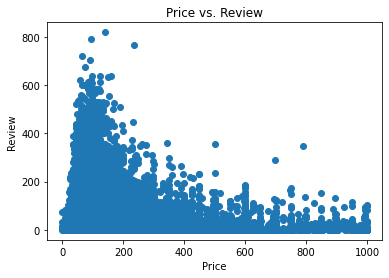

In [12]:
plt.scatter(review_listing['price'],review_listing['number_of_reviews'])
plt.title("Price vs. Review")
plt.xlabel("Price")
plt.ylabel("Review")
plt.show()

From the plot above, we can see that the hosts with lower prices get more reviews from the costomers probably becuase in general cheaper places are more popular.

### Review Distribution
We also looked at the distribution for the number of reviews (as shown below) and figured that most host got about 0-80 reviews. 


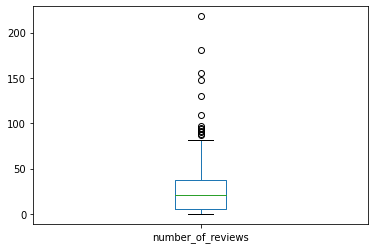

In [14]:
average_price = review_listing.groupby('price').mean()
average_price.plot(kind = 'box')


Then we grouped the number of reviews by price to see a clearer relationship between price and the number of reviees.

In [15]:
average_price = review_listing.groupby('price').mean()
average_price.head()

,number_of_reviews
price,
0,25.800000
10,17.538462
11,0.000000
12,0.700000
13,3.000000


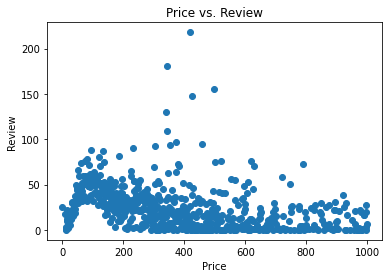

In [16]:
plt.scatter(x=average_price.index, y = average_price['number_of_reviews'])
plt.title("Price vs. Review")
plt.xlabel("Price")
plt.ylabel("Review")
plt.show()

From the plot above, we can see that the average price around 400 got the most number of revies, which shows that airbnb places priced around $400 might be very popular in LA.

## Price vs. Region
Then we decided to look at the price by different regions/neighborhood

In [17]:
listing_df['price_str']=listing_df['price'].astype(str)
listing_df['name_str']=listing_df['name'].astype(str)

In [18]:
from folium.plugins import MarkerCluster

LA_COORDINATES = (34.052235, -118.243683)
location = listing_df[["id","name_str","price_str","longitude","latitude"]]
location.head()
len(location)

38481

### Map Plot for all the hosts with their prices

In [19]:


# for speed purposes
MAX_RECORDS = 20000
# create empty map zoomed in on LA
map_LA = folium.Map(location=LA_COORDINATES, zoom_start=10)

marker_cluster = MarkerCluster().add_to(map_LA)
#creating a Marker for each point in location. Each point will get a popup with their price
for each in location[0:MAX_RECORDS].iterrows():
    marker_cluster.add_child(folium.Marker(location = [each[1]['latitude'],each[1]['longitude']], popup="Price: $%s,Airbnb ID: %s" % (each[1]['price_str'],each[1]['id'])))
 
display(map_LA)



In the map above, we marked all the airbnb locations with markers showing their prices. When zooming out, the number in the circle presents the number of airbnb hosts in the area.

### The Price According to the Neighborhood

For this part, we are interested in the average prices for each neighborhood.

So, first we calculted the average prices for each neighborhood.

In [20]:
regions = listing_df.groupby('neighbourhood').mean()
regions.head()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
neighbourhood,,,,,,,,,,
Acton,2.797610e+07,1.775454e+08,34.489510,-118.177282,129.750000,1.500000,13.750000,1.026667,1.250000,259.000000
Adams-Normandie,2.435140e+07,1.250304e+08,34.031169,-118.299565,98.660000,14.180000,33.600000,1.642000,6.160000,156.660000
Agoura Hills,2.055553e+07,7.511086e+07,34.149974,-118.761387,203.931818,10.704545,24.386364,1.138500,1.386364,203.704545
Agua Dulce,1.794835e+07,4.197501e+07,34.503051,-118.324182,155.714286,5.571429,34.785714,0.983077,2.357143,234.285714
Alhambra,2.730043e+07,1.191205e+08,34.085009,-118.133160,97.373860,4.255319,40.544073,2.504983,4.221884,155.784195


In [21]:
regions.reset_index(inplace=True)
regions['price_str']=round(regions['price'],2).astype(str)
regions['neighbourhood_str']=regions['neighbourhood'].astype(str)
regions

,neighbourhood,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price_str,neighbourhood_str
0,Acton,2.797610e+07,1.775454e+08,34.489510,-118.177282,129.750000,1.500000,13.750000,1.026667,1.250000,259.000000,129.75,Acton
1,Adams-Normandie,2.435140e+07,1.250304e+08,34.031169,-118.299565,98.660000,14.180000,33.600000,1.642000,6.160000,156.660000,98.66,Adams-Normandie
2,Agoura Hills,2.055553e+07,7.511086e+07,34.149974,-118.761387,203.931818,10.704545,24.386364,1.138500,1.386364,203.704545,203.93,Agoura Hills
3,Agua Dulce,1.794835e+07,4.197501e+07,34.503051,-118.324182,155.714286,5.571429,34.785714,0.983077,2.357143,234.285714,155.71,Agua Dulce
4,Alhambra,2.730043e+07,1.191205e+08,34.085009,-118.133160,97.373860,4.255319,40.544073,2.504983,4.221884,155.784195,97.37,Alhambra
...,...,...,...,...,...,...,...,...,...,...,...,...,...
259,Willowbrook,3.261914e+07,1.502872e+08,33.918942,-118.263717,108.789474,5.421053,14.526316,1.789375,2.473684,117.315789,108.79,Willowbrook
260,Wilmington,2.896178e+07,1.724594e+08,33.777647,-118.260712,64.176471,3.794118,51.088235,2.787879,13.852941,293.352941,64.18,Wilmington
261,Windsor Square,2.216734e+07,9.291886e+07,34.071243,-118.320317,526.625000,13.800000,23.025000,1.048125,3.650000,176.450000,526.62,Windsor Square
262,Winnetka,2.864340e+07,1.088333e+08,34.207819,-118.574619,111.912500,10.962500,13.412500,1.273968,2.200000,197.412500,111.91,Winnetka


For this part, we used two different map to represent our result.

### Map 1 
In the map below, we marked different neighborhood with their name and average price as the marker.

In [22]:
from folium.plugins import MarkerCluster
LA_COORDINATES = (34.052235, -118.243683)
region = regions[["neighbourhood_str","price_str","longitude","latitude"]]
# create empty map zoomed in on LA
map_LA = folium.Map(location=LA_COORDINATES, zoom_start=10)

marker_cluster = MarkerCluster().add_to(map_LA)
#creating a Marker for each point in location. Each point will get a popup with their price
for each in region[0:MAX_RECORDS].iterrows():
    marker_cluster.add_child(folium.Marker(location = [each[1]['latitude'],each[1]['longitude']], popup="Average Price: $%s， Neighborhood Name: %s" % (each[1]['price_str'],each[1]['neighbourhood_str'])))
 
display(map_LA)

However, we figured that it's hard to directly see which neighborhood actually has higher prices, because we have to move the mouse to the marker to see the price. Thus, we decided to implement a choropleth graph.

In [23]:
PriceByNeighborhood = pd.DataFrame()
#populate the new dataframe with a Neiborhoood Name column and a 'Average Price' column
PriceByNeighborhood['neiborhood'] = regions.neighbourhood
PriceByNeighborhood['Average Price'] = regions.price
PriceByNeighborhood['Price_str'] = regions['price'].astype(str)
PriceByNeighborhood.head()

,neiborhood,Average Price,Price_str
0,Acton,129.750000,129.75
1,Adams-Normandie,98.660000,98.66
2,Agoura Hills,203.931818,203.9318181818182
3,Agua Dulce,155.714286,155.71428571428572
4,Alhambra,97.373860,97.37386018237082


In [24]:
neighbourhoods_geo = Path(data_path_str+'/neighbourhoods.geojson')
with open(neighbourhoods_geo) as f:
    Neighbourhoods_geo = json.load(f)

## Above and Beyond
### Map 2 Choropleth Graph 

As mentioned above, in order to better represent the average prices for different neighborhoods, we decided our map according to their neighborhood and mark the color using the average price.

In [25]:
bins = [0,100,400,800,1600,3200]
laMap = folium.Map(location=[34.0522,-118.2437], zoom_start=9)
#laMap.choropleth(geo_data=Neighbourhoods_geo, data=PriceByNeighborhood, columns=['Neiborhoood Name', 'Average Price'], \
                # key_on='feature.id', fill_color='YlGn', fill_opacity=1)

laMap.choropleth(
 geo_data=Neighbourhoods_geo,
 name='choropleth for LA',
 data=PriceByNeighborhood,
 columns=['neiborhood', 'Average Price'],
  key_on='feature.properties.neighbourhood',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.3,
 legend_name='Average Price ($)',
 highlight = True,
 threshold_scale=bins
)

display(laMap)

From the graph above, we can see that most airbnb hostings in LA are priced below $400, but the airbnb hosting near Beverly Crest, Bel-Air, Hollywood Hills, and Malibu are priced very high. 

# Part 2

In [ ]:
!pip install chart_studio
import chart_studio.plotly as py
import plotly.graph_objs as go

import plotly.express as px


#read your plotly credentials from creds.py
from chart_studio.tools import set_credentials_file
from creds import *
set_credentials_file(username=username, api_key=api_key)
px.set_mapbox_access_token(mapbox_access_token)

In [28]:
review_summary_df = pd.read_csv(Path(data_path_str+'/reviews.csv'))
review_detail_df = pd.read_csv(Path(data_path_str+'/reviews_detail.csv'))
calendar_df = pd.read_csv(Path(data_path_str+'/calendar.csv'))
listing_df = pd.read_csv(Path(data_path_str+'/listings.csv'))
listing_detail_df = pd.read_csv(Path(data_path_str+'/listings_detail.csv'), parse_dates=True, infer_datetime_format=True)
neighbourhoods_df = pd.read_csv(Path(data_path_str+'/neighbourhoods.csv'))

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (61,62) have mixed types.Specify dtype option on import or set low_memory=False.



First, we can see how many people became host over the years and when is the first host appears in Los Angeles area. 

In [29]:
listing_detail_df.host_since = pd.to_datetime(listing_detail_df.host_since, format='%Y-%m-%d')
listing_detail_df['host_since_year'] = [i.year for i in listing_detail_df.host_since]
fig = px.histogram(listing_detail_df, x='host_since_year')
fig.show()

# Animation on host over years in Mapbox

First, we need to figure out the host and their first listing in Airbnb. By merging the information from two tables, we can have a table containing the year when the host joined, the longitude and the latitude of their listings. 

In [30]:
# Convert objects in host_since column into datetime objects 
listing_detail_df.host_since = pd.to_datetime(listing_detail_df.host_since, format='%Y-%m-%d') 
# Merge two tables
df_a = listing_detail_df[['id','host_since', 'host_id']]
df_b = listing_df[['id', 'longitude', 'latitude']]
df_listing_location = pd.merge(df_a, df_b, how='inner', on='id')

In [31]:
print(df_a.info())
print(df_listing_location.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38481 entries, 0 to 38480
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   id          38481 non-null  int64         
 1   host_since  38474 non-null  datetime64[ns]
 2   host_id     38481 non-null  int64         
dtypes: datetime64[ns](1), int64(2)
memory usage: 902.0 KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 38481 entries, 0 to 38480
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   id          38481 non-null  int64         
 1   host_since  38474 non-null  datetime64[ns]
 2   host_id     38481 non-null  int64         
 3   longitude   38481 non-null  float64       
 4   latitude    38481 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(2)
memory usage: 1.8 MB
None


From the information above, we can see that there are some missing value for host_since, so we need to clean it up later. Then, we observe that there are 22274 hosts in our dataset, but there are 38481 listings. Therefore, some of the hosts have multiple listings. 

For those who have multiple listings, we pick one of their listings to be the representative in our visualization.

In [32]:
# Take the first value from each of the group
subset = df_listing_location.groupby('host_id').nth(0)

In [33]:
# Extract years from the host_since and make a column
# Observe the NULL value and drop the rows containing NULL values
subset = subset.dropna()
subset['year'] = [date.strftime("%Y") for date in subset['host_since']]

In [35]:
years = np.sort(subset['year'].unique())

In [36]:
frame_list_lat = [list(subset[subset['year'] == i]['latitude']) for i in years]
frame_list_long =  [list(subset[subset['year'] == i]['longitude']) for i in years]

Here is the start of constructing animation on Mapbox figure. First, the animation needs a figure dictionary that contains all information, including data, layout and frames. In Python, be aware of the ways of declaring a dictionary. In fig_dict, data is a list containing the information for the first frame; layout is a dictionary containing the configuration to the figure(slides, map, etc.); frames contains multiple frame dictionaries. 

In [37]:
fig_dict = {
    "data": [],
    "layout": {},
    "frames": []
}

In [38]:
fig_dict["layout"]["hovermode"] = "closest"

In [39]:
# Two different ways of declaring dictionary
fig_dict["layout"]["mapbox"] = dict(
    accesstoken=mapbox_access_token,
    bearing = 0, # bearing angle of the map in degrees counter-clockwise from North
    center = dict( lat=34.067748, lon=-118.250270 ),
    pitch = 0, # pitch angle - 0 means perpendicular to the surface
    zoom = 9, 
    style = 'light',
)

In [40]:
fig_dict['layout']['width'] = 1024
fig_dict['layout']['height'] = 768

In [41]:
fig_dict["layout"]["updatemenus"] = [
    {
        "buttons": [
            {   # Pass to Plotly method on click
                "args": [None, {"frame": {"duration": 500, "redraw": True},
                                "fromcurrent": True, "transition": {"duration": 400,
                                "easing": "cubic-in-out"}}], 
                "label": "Play",
                "method": "animate"
            },
            { 
                "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                  "mode": "immediate",
                                  "transition": {"duration": 0}}],
                "label": "Pause",
                "method": "animate"
            }
        ],
        "direction": "up", # the direction in which the buttons are laid out
        "pad": {"r": 20, "t": 50},
        "showactive": False, 
        "type": "buttons",
        "x": 0.1,
        "xanchor": "right",
        "y": 0,
        "yanchor": "top"
    }
]

In [42]:
sliders_dict = {
    "active": 0,
    "yanchor": "top",
    "xanchor": "left",
    "currentvalue": {
        "font": {"size": 20},
        "prefix": "Year:",
        "visible": True,
        "xanchor": "right"
    },
    "transition": {"duration": 400, "easing": "cubic-in-out"},
    "pad": {"b": 10, "t": 50},
    "len": 0.9,
    "x": 0.1,
    "y": 0,
    "steps": []
}

In [43]:
year = 2008

data_list_lat = list(subset[subset['year'] == year]['latitude'])
data_list_long =  list(subset[subset['year'] == year]['longitude'])

data_dict = {
    "type": "scattermapbox",
    "lat": data_list_lat,
    "lon": data_list_long,
    "mode": "markers",
    # "text": list(zip(data_list_lat, data_list_long)),
    "marker": {
        # "symbol": "205",
        "size": 4,
        "color": "red",
        "opacity": 0.5
    },
}
fig_dict["data"].append(data_dict)

In [44]:
# make frames
for year in years:
    frame = {"data": [], "name": str(year)}


    data_list_lat = list(subset[subset['year'] == year]['latitude'])
    data_list_long =  list(subset[subset['year'] == year]['longitude'])

    data_dict = {
        "type": "scattermapbox",
        "lat": data_list_lat,
        "lon": data_list_long,
        "mode": "markers",
        # "text": list(zip(data_list_lat, data_list_long)),
        "marker": {
            "size": 4,
            "color": "red",
            "opacity": 0.5
        },
    }
    frame["data"].append(data_dict)


    fig_dict["frames"].append(frame)
    slider_step = {"args": [
        [year],
        {"frame": {"duration": 500, "redraw": True},
         "mode": "immediate",
         "transition": {"duration": 400,
                        "easing": "cubic-in-out"}}
    ],
        "label": year,
        "method": "animate"}
    sliders_dict["steps"].append(slider_step)

In [45]:
fig_dict["layout"]["sliders"] = [sliders_dict]

fig = go.Figure(fig_dict)

fig.show()